# Rotten Tomatoes Critical Rating vs Runtime and Critical Rating vs Genre 

# Import Pandas, Numpy, etc. and EDA on RT Data

In [90]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

rt_movies_df = pd.read_csv('data/zippedData/rt.movie_info.tsv.gz', sep='\t')
rt_reviews_df = pd.read_csv('data/zippedData/rt.reviews.tsv.gz', sep='\t', encoding= 'unicode_escape')

In [91]:
rt_movies_df.head()

,id,synopsis,rating,genre,director,writer,theater_date,dvd_date,currency,box_office,runtime,studio
0,1,"This gritty, fast-paced, and innovative police drama earned five Academy Awards, including Best Picture, Best Adapted Screenplay (written by Ernest Tidyman), and Best Actor (Gene Hackman). Jimmy ""Popeye"" Doyle (Hackman) and his partner, Buddy Russo (Roy Scheider), are New York City police detectives on narcotics detail, trying to track down the source of heroin from Europe into the United States. Suave Alain Charnier (Fernando Rey) is the French drug kingpin who provides a large percentage of New York City's dope, and Pierre Nicoli (Marcel Bozzuffi) is a hired killer and Charnier's right-hand man. Acting on a hunch, Popeye and Buddy start tailing Sal Boca (Tony Lo Bianco) and his wife, Angie (Arlene Faber), who live pretty high for a couple whose corner store brings in about 7,000 dollars a year. It turns out Popeye's suspicions are right -- Sal and Angie are the New York agents for Charnier, who will be smuggling 32 million dollars' worth of heroin into the city in a car shipped over from France. The French Connection broke plenty of new ground for screen thrillers; Popeye Doyle was a highly unusual ""hero,"" an often violent, racist, and mean-spirited cop whose dedication to his job fell just short of dangerous obsession. The film's high point, a high-speed car chase with Popeye tailing an elevated train, was one of the most viscerally exciting screen moments of its day and set the stage for dozens of action sequences to follow. And the film's grimy realism (and downbeat ending) was a big change from the buff-and-shine gloss and good-guys-always-win heroics of most police dramas that preceded it. The French Connection was inspired by a true story, and Eddie Egan and Sonny Grosso, Popeye and Buddy's real life counterparts, both have small roles in the film. A sequel followed four years later.",R,Action and Adventure|Classics|Drama,William Friedkin,Ernest Tidyman,"Oct 9, 1971","Sep 25, 2001",NaN,NaN,104 minutes,NaN
1,3,"New York City, not-too-distant-future: Eric Packer, a 28 year-old finance golden boy dreaming of living in a civilization ahead of this one, watches a dark shadow cast over the firmament of the Wall Street galaxy, of which he is the uncontested king. As he is chauffeured across midtown Manhattan to get a haircut at his father's old barber, his anxious eyes are glued to the yuan's exchange rate: it is mounting against all expectations, destroying Eric's bet against it. Eric Packer is losing his empire with every tick of the clock. Meanwhile, an eruption of wild activity unfolds in the city's streets. Petrified as the threats of the real world infringe upon his cloud of virtual convictions, his paranoia intensifies during the course of his 24-hour cross-town odyssey. Packer starts to piece together clues that lead him to a most terrifying secret: his imminent assassination. -- (C) Official Site",R,Drama|Science Fiction and Fantasy,David Cronenberg,David Cronenberg|Don DeLillo,"Aug 17, 2012","Jan 1, 2013",$,"600,000",108 minutes,Entertainment One
2,5,"Illeana Douglas delivers a superb performance as Denise Waverly, a fictional singer and songwriter whose life bears more than a passing resemblance to that of real-life pop star Carole King. Edna Buxton, the daughter of a Philadelphia steel tycoon, aspires to a career as a singer, and when against her mother's bidding she sings a sultry version of ""Hey There (You With the Stars in Your Eyes)"" (instead of Mom's choice, ""You'll Never Walk Alone"") at a talent contest, she wins a recording contact and moves to New York City. She cuts a record and gains a new stage name, Denise Waverly; however, she soon finds that girl singers are a dime a dozen in the Big Apple and her career as a vocalist goes nowhere. But she has a knack for writing songs, and eccentric producer Joel Milner (John Turturro) asks her to pen some songs for his upcoming projects. Teamed with Howar

In [92]:
rt_movies_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1560 entries, 0 to 1559
Data columns (total 12 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   id            1560 non-null   int64 
 1   synopsis      1498 non-null   object
 2   rating        1557 non-null   object
 3   genre         1552 non-null   object
 4   director      1361 non-null   object
 5   writer        1111 non-null   object
 6   theater_date  1201 non-null   object
 7   dvd_date      1201 non-null   object
 8   currency      340 non-null    object
 9   box_office    340 non-null    object
 10  runtime       1530 non-null   object
 11  studio        494 non-null    object
dtypes: int64(1), object(11)
memory usage: 146.4+ KB


In [93]:
rt_movies_df.shape

(1560, 12)

In [94]:
rt_reviews_df.head(30)

,id,review,rating,fresh,critic,top_critic,publisher,date
0,3,"A distinctly gallows take on contemporary financial mores, as one absurdly rich man's limo ride across town for a haircut functions as a state-of-the-nation discourse.",3/5,fresh,PJ Nabarro,0,Patrick Nabarro,"November 10, 2018"
1,3,It's an allegory in search of a meaning that never arrives...It's just old-fashioned bad storytelling.,NaN,rotten,Annalee Newitz,0,io9.com,"May 23, 2018"
2,3,... life lived in a bubble in financial dealings and digital communications and brief face-to-face conversations and sexual intermissions in a space shuttle of a limousine creeping through the gridlock of an anonymous New York City.,NaN,fresh,Sean Axmaker,0,Stream on Demand,"January 4, 2018"
3,3,"Continuing along a line introduced in last year's ""A Dangerous Method"", David Cronenberg pushes his cinema towards a talky abstraction in his uncanny, perversely funny and frighteningly insular adaptation of Don DeLillo, ""Cosmopolis"".",NaN,fresh,Daniel Kasman,0,MUBI,"November 16, 2017"
4,3,... a perverse twist on neorealism...,NaN,fresh,NaN,0,Cinema Scope,"October 12, 2017"
5,3,"... Cronenberg's Cosmopolis expresses something new and necessary about the book, which is to say about limits, the gaps in what can be known, both within and between us.",NaN,fresh,Michelle Orange,0,Capital New York,"September 11, 2017"
6,3,"Quickly grows repetitive and tiresome, meandering toward messages that land softly, producing little impact.",C,rotten,Eric D. Snider,0,EricDSnider.com,"July 17, 2013"
7,3,Cronenberg is not a director to be daunted by a scenario in which the antihero spends most of his time in a stretch limo. Turning it into a film that interests anyone ... is another matter,2/5,rotten,Matt Kelemen,0,Las Vegas CityLife,"April 21, 2013"
8,3,"Cronenberg's cold, exacting precision and emotionally removed observation may not grab all viewers, but under those perfect surfaces is a raw horror trying to claw out of the denial.",NaN,fresh,Sean Axmaker,0,Parallax View,"March 24, 2013"
9,3,"Over and above its topical urgency or the bit about the misfortune of globalism, it does what this director has always done in his films: split open the head of a character, plunge inside and try to visualise the bad and the ugly things to be found there.",NaN,fresh,Kong Rithdee,0,Bangkok Post,"March 4, 2013"


In [95]:
rt_reviews_df.shape

(54432, 8)

In [96]:
rt_reviews_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 54432 entries, 0 to 54431
Data columns (total 8 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   id          54432 non-null  int64 
 1   review      48869 non-null  object
 2   rating      40915 non-null  object
 3   fresh       54432 non-null  object
 4   critic      51710 non-null  object
 5   top_critic  54432 non-null  int64 
 6   publisher   54123 non-null  object
 7   date        54432 non-null  object
dtypes: int64(2), object(6)
memory usage: 3.3+ MB


In [97]:
rt_reviews_df.dropna()

,id,review,rating,fresh,critic,top_critic,publisher,date
0,3,"A distinctly gallows take on contemporary financial mores, as one absurdly rich man's limo ride across town for a haircut functions as a state-of-the-nation discourse.",3/5,fresh,PJ Nabarro,0,Patrick Nabarro,"November 10, 2018"
6,3,"Quickly grows repetitive and tiresome, meandering toward messages that land softly, producing little impact.",C,rotten,Eric D. Snider,0,EricDSnider.com,"July 17, 2013"
7,3,Cronenberg is not a director to be daunted by a scenario in which the antihero spends most of his time in a stretch limo. Turning it into a film that interests anyone ... is another matter,2/5,rotten,Matt Kelemen,0,Las Vegas CityLife,"April 21, 2013"
11,3,"While not one of Cronenberg's stronger films, this anti-capitalist adaptation still merits attention.",B-,fresh,Emanuel Levy,0,EmanuelLevy.Com,"February 3, 2013"
12,3,Robert Pattinson works mighty hard to make Cosmopolis more than just an erudite slap at modern capitalism. The Twilight heartthrob ultimately fails to rescue a meandering story hitting stale versions of the same talking points.,2/4,rotten,Christian Toto,0,Big Hollywood,"January 15, 2013"
13,3,"The anger over the injustice of the financial collapse and bailout is what powered the Tea Party movement as well as the Occupy Wall Street movement, and it powers this movie, too.",B,fresh,Robert Roten,0,Laramie Movie Scope,"January 7, 2013"
14,3,For those who like their Cronenberg thick and chewy,3/4,fresh,Marty Mapes,0,Movie Habit,"October 20, 2012"
15,3,"For better or worse - often both - Cosmopolis is a quintessential David Cronenberg film. Cosmopolis is simultaneously fascinating and impenetrable, profound and absurd, labyrinthine yet intimate.",3/5,fresh,Adam Ross,0,The Aristocrat,"September 27, 2012"
16,3,"For one of the smartest films I've seen in a while, Cosmopolis is also one of the least outwardly enjoyable. That by no means makes it anything less than a great film however.",4/5,fresh,Patrick Kolan,0,Shotgun Cinema,"September 26, 2012"
17,3,Its major problem is that it's not cinematic.,B,fresh,Dennis Schwartz,0,Ozus' World Movie Reviews,"September 25, 2012"


# Data Cleaning Of Fresh vs Rotten and Rating Scale 

In [98]:
rt_reviews_df['fresh'].value_counts()

fresh     33035
rotten    21397
Name: fresh, dtype: int64

In [99]:
rt_reviews_df['rating'].value_counts()

3/5       4327
4/5       3672
3/4       3577
2/5       3160
2/4       2712
2.5/4     2381
3.5/4     1777
3.5/5     1289
5/5       1237
B         1163
1/5       1113
1.5/4     1095
4/4       995 
2.5/5     992 
B+        832 
1/4       822 
B-        821 
C         779 
C+        665 
4.5/5     567 
7/10      522 
A-        514 
8/10      505 
C-        493 
6/10      468 
1.5/5     405 
A         397 
5/10      351 
D         324 
9/10      304 
4/10      252 
D+        204 
0/5       162 
8         143 
3/10      140 
1         138 
0/4       132 
7         125 
F         109 
0.5/4     100 
D-        84  
6         82  
2/10      73  
A+        73  
7.5/10    58  
0.5/5     52  
5         48  
8.5/10    41  
6.5/10    39  
4         34  
3         33  
9         33  
1/10      30  
5.5/10    27  
3.0/4     21  
4.5/10    21  
3.5       18  
9.5/10    17  
3/6       14  
3.0/5     12  
2.0/5     12  
2         11  
4.0/4     11  
2.1/2     9   
4/6       9   
5.0/5     9   
2.5       

# Joining Movies & Review RT sets

In [100]:
joinedrt = rt_movies_df.set_index('id').join(rt_reviews_df, on = 'id', lsuffix = ' guidelines', rsuffix =' critical')

In [101]:
joinedrt.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1560 entries, 1 to 2000
Data columns (total 19 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   synopsis           1498 non-null   object
 1   rating guidelines  1557 non-null   object
 2   genre              1552 non-null   object
 3   director           1361 non-null   object
 4   writer             1111 non-null   object
 5   theater_date       1201 non-null   object
 6   dvd_date           1201 non-null   object
 7   currency           340 non-null    object
 8   box_office         340 non-null    object
 9   runtime            1530 non-null   object
 10  studio             494 non-null    object
 11  id                 1560 non-null   int64 
 12  review             1380 non-null   object
 13  rating critical    1157 non-null   object
 14  fresh              1560 non-null   object
 15  critic             1484 non-null   object
 16  top_critic         1560 non-null   int64 


In [102]:
joinedrt.head()

,synopsis,rating guidelines,genre,director,writer,theater_date,dvd_date,currency,box_office,runtime,studio,id,review,rating critical,fresh,critic,top_critic,publisher,date
id,,,,,,,,,,,,,,,,,,,
1,"This gritty, fast-paced, and innovative police drama earned five Academy Awards, including Best Picture, Best Adapted Screenplay (written by Ernest Tidyman), and Best Actor (Gene Hackman). Jimmy ""Popeye"" Doyle (Hackman) and his partner, Buddy Russo (Roy Scheider), are New York City police detectives on narcotics detail, trying to track down the source of heroin from Europe into the United States. Suave Alain Charnier (Fernando Rey) is the French drug kingpin who provides a large percentage of New York City's dope, and Pierre Nicoli (Marcel Bozzuffi) is a hired killer and Charnier's right-hand man. Acting on a hunch, Popeye and Buddy start tailing Sal Boca (Tony Lo Bianco) and his wife, Angie (Arlene Faber), who live pretty high for a couple whose corner store brings in about 7,000 dollars a year. It turns out Popeye's suspicions are right -- Sal and Angie are the New York agents for Charnier, who will be smuggling 32 million dollars' worth of heroin into the city in a car shipped over from France. The French Connection broke plenty of new ground for screen thrillers; Popeye Doyle was a highly unusual ""hero,"" an often violent, racist, and mean-spirited cop whose dedication to his job fell just short of dangerous obsession. The film's high point, a high-speed car chase with Popeye tailing an elevated train, was one of the most viscerally exciting screen moments of its day and set the stage for dozens of action sequences to follow. And the film's grimy realism (and downbeat ending) was a big change from the buff-and-shine gloss and good-guys-always-win heroics of most police dramas that preceded it. The French Connection was inspired by a true story, and Eddie Egan and Sonny Grosso, Popeye and Buddy's real life counterparts, both have small roles in the film. A sequel followed four years later.",R,Action and Adventure|Classics|Drama,William Friedkin,Ernest Tidyman,"Oct 9, 1971","Sep 25, 2001",NaN,NaN,104 minutes,NaN,3,It's an allegory in search of a meaning that never arrives...It's just old-fashioned bad storytelling.,NaN,rotten,Annalee Newitz,0,io9.com,"May 23, 2018"
3,"New York City, not-too-distant-future: Eric Packer, a 28 year-old finance golden boy dreaming of living in a civilization ahead of this one, watches a dark shadow cast over the firmament of the Wall Street galaxy, of which he is the uncontested king. As he is chauffeured across midtown Manhattan to get a haircut at his father's old barber, his anxious eyes are glued to the yuan's exchange rate: it is mounting against all expectations, destroying Eric's bet against it. Eric Packer is losing his empire with every tick of the clock. Meanwhile, an eruption of wild activity unfolds in the city's streets. Petrified as the threats of the real world infringe upon his cloud of virtual convictions, his paranoia intensifies during the course of his 24-hour cross-town odyssey. Packer starts to piece together clues that lead him to a most terrifying secret: his imminent assassination. -- (C) Official Site",R,Drama|Science Fiction and Fantasy,David Cronenberg,David Cronenberg|Don DeLillo,"Aug 17, 2012","Jan 1, 2013",$,"600,000",108 minutes,Entertainment One,3,"Continuing along a line introduced in last year's ""A Dangerous Method"", David Cronenberg pushes his cinema towards a talky abstraction in his uncanny, perversely funny and frighteningly insular adaptation of Don DeLillo, ""Cosmopolis"".",NaN,fresh,Daniel Kasman,0,MUBI,"November 16, 2017"
5,"Illeana Douglas delivers a superb performance as Denise Waverly, a fictional singer and songwriter whose life bears more than a passing resemblance to that of real-life pop star Carole King. Edna Buxton, the daughter of a Philadelphia steel tycoon, aspires to a career as a singer, and when against her mother's bidding she sings a sult

In [103]:
joinedrt['fresh'].value_counts()

fresh     1073
rotten    487 
Name: fresh, dtype: int64

In [104]:
joinedrt['runtime'].value_counts()

90 minutes     72
95 minutes     66
100 minutes    51
93 minutes     47
96 minutes     43
98 minutes     41
91 minutes     40
92 minutes     38
94 minutes     37
89 minutes     36
105 minutes    36
110 minutes    35
104 minutes    35
120 minutes    33
108 minutes    33
85 minutes     32
97 minutes     29
101 minutes    28
99 minutes     28
88 minutes     27
114 minutes    27
103 minutes    26
111 minutes    26
115 minutes    25
102 minutes    25
107 minutes    24
86 minutes     23
106 minutes    23
109 minutes    22
80 minutes     21
119 minutes    21
117 minutes    20
84 minutes     19
112 minutes    19
116 minutes    18
118 minutes    18
87 minutes     18
113 minutes    16
126 minutes    16
83 minutes     15
127 minutes    13
121 minutes    13
125 minutes    11
133 minutes    10
123 minutes    10
129 minutes    10
128 minutes    10
124 minutes    10
82 minutes     9 
60 minutes     9 
70 minutes     8 
122 minutes    8 
75 minutes     8 
130 minutes    7 
132 minutes    6 
142 minute

In [105]:
joinedrt.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1560 entries, 1 to 2000
Data columns (total 19 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   synopsis           1498 non-null   object
 1   rating guidelines  1557 non-null   object
 2   genre              1552 non-null   object
 3   director           1361 non-null   object
 4   writer             1111 non-null   object
 5   theater_date       1201 non-null   object
 6   dvd_date           1201 non-null   object
 7   currency           340 non-null    object
 8   box_office         340 non-null    object
 9   runtime            1530 non-null   object
 10  studio             494 non-null    object
 11  id                 1560 non-null   int64 
 12  review             1380 non-null   object
 13  rating critical    1157 non-null   object
 14  fresh              1560 non-null   object
 15  critic             1484 non-null   object
 16  top_critic         1560 non-null   int64 


In [106]:
joinedrt = joinedrt.dropna(subset = ['runtime'])

In [107]:
joinedrt.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1530 entries, 1 to 2000
Data columns (total 19 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   synopsis           1485 non-null   object
 1   rating guidelines  1530 non-null   object
 2   genre              1526 non-null   object
 3   director           1345 non-null   object
 4   writer             1100 non-null   object
 5   theater_date       1194 non-null   object
 6   dvd_date           1194 non-null   object
 7   currency           338 non-null    object
 8   box_office         338 non-null    object
 9   runtime            1530 non-null   object
 10  studio             489 non-null    object
 11  id                 1530 non-null   int64 
 12  review             1352 non-null   object
 13  rating critical    1138 non-null   object
 14  fresh              1530 non-null   object
 15  critic             1455 non-null   object
 16  top_critic         1530 non-null   int64 


# Mapping Fresh Score to 0/1 and Normalizing Rating Systems

In [108]:
joinedrt['freshnum'] = joinedrt['fresh'].map({'fresh': 1, 'rotten': 0})

In [109]:
#pd.set_option('display.max_rows', None)
#pd.set_option('display.max_columns', None)
#pd.set_option('display.width', None)
#pd.set_option('display.max_colwidth', -1)

<ipython-input-109-1390d13c0cdd>:4: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  pd.set_option('display.max_colwidth', -1)


In [110]:
joinedrt['rating critical'].value_counts()

3/4       139
4/5       124
3/5       102
3.5/4     79 
2/4       61 
2/5       61 
2.5/4     56 
3.5/5     40 
5/5       38 
B         38 
4/4       37 
B+        32 
A-        27 
1/5       22 
2.5/5     19 
8/10      19 
4.5/5     18 
B-        18 
A         16 
1.5/4     16 
C+        13 
6/10      13 
1/4       12 
9/10      12 
C         12 
C-        11 
7/10      9  
5/10      9  
1.5/5     9  
0/5       8  
1         6  
8         6  
4/10      4  
7         4  
D+        4  
0.5/4     3  
6         3  
D         3  
3/10      3  
3         2  
4.0/4     2  
8.5/10    2  
0/4       2  
8.4/10    2  
9         2  
1/10      2  
A+        2  
D-        2  
0         1  
3.7/5     1  
0.5/10    1  
5.0/5     1  
2.2/5     1  
F         1  
2.5       1  
2/10      1  
7.5/10    1  
5         1  
2.0/5     1  
7.7       1  
3.0/5     1  
2         1  
Name: rating critical, dtype: int64

In [111]:
joinedrt['rating critical'] = joinedrt['rating critical'].replace({'3/4' : 75, '4/5' : 80, '3/5' : 60, '1/4': 25, '1/5': 20,'3.5/4' : 87, '2/5': 40, '2/4': 50, '3.7/5': 74})

In [112]:
joinedrt['rating critical'] = joinedrt['rating critical'].replace({'2.5/4': 63, '3.5/5' : 70, '5/5': 100, 'B': 85, '4/4': 100, 'B+': 88, "A-": 93, '2.5/5' : 50, "8/10" : 80, 'B-': 82, '4.5/5': 90, '1.5/4': 37.5, 'A': 95, '6/10': 60, 'C+': 77, '9/10': 90, "C": 74, 'C-': 72, '5/10': 50, '1.5/5': 30, '7/10': 70})

In [113]:
joinedrt['rating critical'] = joinedrt['rating critical'].replace({'0/5':0, '8': 80, '1': 10, '4/10': 40, 'D+': 69, '7': 70, '3/10': 30, 'D': 67, "0.5/4": 13, '6': 60}) 

In [114]:
joinedrt['rating critical'] = joinedrt['rating critical'].replace({"3": 30, "D-": 66, "1/10": 10, '0/4' : 0, '8.5/10': 85, "A+": 98, '4.0/4': 100, "8.4/10": 84, "9": 90, "F": 35, "7.5/10": 75, "7.7": 77, "2": 20, "0": 0, "2.0/5": 40, '0.5/10': 5}) 

In [115]:
joinedrt['rating critical'] = joinedrt['rating critical'].replace({'2/10': 20, '5.0/5': 100, '3.0/5': 60, "2.5": 50, '5': 50, '2.2/5': 44})

In [116]:
joinedrt['rating critical'].value_counts()

80.0     149
75.0     140
60.0     119
50.0     91 
87.0     79 
100.0    78 
40.0     66 
63.0     56 
70.0     53 
85.0     40 
88.0     32 
90.0     32 
93.0     27 
20.0     24 
82.0     18 
95.0     16 
37.5     16 
77.0     14 
30.0     14 
74.0     13 
25.0     12 
0.0      11 
72.0     11 
10.0     8  
69.0     4  
67.0     3  
13.0     3  
66.0     2  
98.0     2  
84.0     2  
35.0     1  
44.0     1  
5.0      1  
Name: rating critical, dtype: int64

The rating systems for different critics and their respective websites vary drastically. This can be anything from an A-F rating or a 0-100 rating with demicals. I normalized all of the ratings on a scale of 0-100 without decimals. 

In [117]:
joinedrt.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1530 entries, 1 to 2000
Data columns (total 20 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   synopsis           1485 non-null   object 
 1   rating guidelines  1530 non-null   object 
 2   genre              1526 non-null   object 
 3   director           1345 non-null   object 
 4   writer             1100 non-null   object 
 5   theater_date       1194 non-null   object 
 6   dvd_date           1194 non-null   object 
 7   currency           338 non-null    object 
 8   box_office         338 non-null    object 
 9   runtime            1530 non-null   object 
 10  studio             489 non-null    object 
 11  id                 1530 non-null   int64  
 12  review             1352 non-null   object 
 13  rating critical    1138 non-null   float64
 14  fresh              1530 non-null   object 
 15  critic             1455 non-null   object 
 16  top_critic         1530 

# Studio Data Cleaning

In [118]:
joinedrt['studio'] = joinedrt['studio'].replace({'Sony Pictures Classics':'Sony Pictures',  '20th Century Fox Distribution': '20th Century Fox','20th Century Fox Film Corporat': '20th Century Fox', 'A24': 'A24 Films', 'A24 and DIRECTV': 'A24 Films', 'Sony Pictures Releasing': 'Sony Pictures'})

In [119]:
joinedrt['studio'] = joinedrt['studio'].replace({'Lions Gate Films': "Lionsgate Films", 'Lionsgate': 'Lionsgate Films', "Paramount Vantage": "Paramount Pictures", 'Paramount Classics': "Paramount Pictures", "Paramount": 'Paramount Pictures'})

In [120]:
joinedrt['studio'] = joinedrt['studio'].replace({'Sony Pictures Home Entertainment':'Sony Pictures','Warner Bros. Pictures':'Warner Bros.', 'Universal Studios':'Universal Pictures','Sony Pictures Entertainment':'Sony Pictures','Sony Classics':'Sony Pictures', 'Paramount Home Video': 'Paramount Pictures', 'Universal':'Universal Pictures','Lions Gate':"Lionsgate Films",'Dreamworks/Paramount':'Paramount Pictures','Universal Pictures International':'Universal Pictures','Paramount Studios': 'Paramount Pictures'})                                       

In [121]:
joinedrt['studio'] = joinedrt['studio'].replace({'Lionsgate/Roadside Attractions': "Lionsgate Films", 'WARNER BROTHERS PICTURES': 'Warner Bros', 'Lions Gate Releasing':'Lionsgate Films','Twentieth Century Fox':'20th Century Fox','Fox International':'20th Century Fox','Lionsgate Films/After Dark Films':'Lionsgate Films', 'Universal Pictures Distributio':'Universal Pictures','Miramax':'Miramax Films'})

In [122]:
joinedrt['studio'] = joinedrt['studio'].replace({'Sony Pictures/Columbia':'Sony Pictures','IFC':'IFC Films','Sony Pictures/TriStar Pictures':'Sony Pictures'})

In [123]:
joinedrt['studio'] = joinedrt['studio'].replace({'Twentieth Century Fox Home Entertainment':'20th Century Fox','IFC First Take':'IFC Films','Lions Gate Films Inc.':'Lionsgate Films', 'WB':'Warner Bros.','Fox':'20th Century Fox','Warner Bros':'Warner Bros.','Walt Disney Animation Studios':'Walt Disney Pictures','Disneynature':'Walt Disney Pictures','Weinstein Company':'The Weinstein Company','The Weinstein Co.':'The Weinstein Company'})

In [126]:
joinedrt['studio'] = joinedrt['studio'].replace({'Weinstein Co.':'The Weinstein Company','Universal Studios Home Video':'Universal Pictures','United Artists Pictures/MGM':'MGM','Fox Searchlight':'Fox Searchlight Pictures','Sony Pictures/Columbia Pictures':'Columbia Pictures','Universal Studios Home Video':'Universal Pictures','New Line Home Entertainment':'New Line Cinema','Screen Gems/SONY PICTURES':'Sony Pictures','MGM/UA':'MGM','Buena Vista Distribution Compa':'Buena Vista Pictures'})

In [161]:
joinedrt['studio'].value_counts()

Sony Pictures                              47
Universal Pictures                         41
Paramount Pictures                         38
20th Century Fox                           33
Warner Bros.                               32
Lionsgate Films                            22
New Line Cinema                            12
Columbia Pictures                          12
Fox Searchlight Pictures                   11
Miramax Films                              11
IFC Films                                  11
The Weinstein Company                      9 
MGM                                        9 
Buena Vista Pictures                       8 
Magnolia Pictures                          7 
Walt Disney Pictures                       7 
Roadside Attractions                       6 
Focus Features                             6 
A24 Films                                  5 
Summit Entertainment                       5 
Open Road Films                            3 
Tribeca Film                      

In [162]:
joinedrtstudio = joinedrt.sort_values('studio')

In [163]:
joinedrtstudio.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1530 entries, 428 to 1999
Data columns (total 21 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   synopsis           1485 non-null   object 
 1   rating guidelines  1530 non-null   object 
 2   genre              1526 non-null   object 
 3   director           1345 non-null   object 
 4   writer             1100 non-null   object 
 5   theater_date       1194 non-null   object 
 6   dvd_date           1194 non-null   object 
 7   currency           338 non-null    object 
 8   box_office         338 non-null    object 
 9   runtime            1530 non-null   object 
 10  studio             489 non-null    object 
 11  id                 1530 non-null   int64  
 12  review             1352 non-null   object 
 13  rating critical    1138 non-null   float64
 14  fresh              1530 non-null   object 
 15  critic             1455 non-null   object 
 16  top_critic         153

In [164]:
joinedrtstudiocleaned = joinedrtstudio.dropna(subset=['studio'])

In [165]:
joinedrtstudiocleaned2 = joinedrtstudiocleaned.groupby('studio').mean()

In [166]:
joinedrtstudiocleaned2.shape

(148, 5)

In [168]:
joinedrtstudiocleaned2['numberofmovies'] = joinedrt['studio'].value_counts()

In [169]:
joinedrtstudiocleaned2.head()

,id,rating critical,top_critic,freshnum,numberofmovies
studio,,,,,
20th Century Fox,31.363636,64.854167,0.333333,0.636364,33
A24 Films,28.600000,62.500000,0.200000,0.600000,5
ADV Films,52.000000,75.000000,0.000000,1.000000,1
ATO Pictures,3.000000,80.000000,0.000000,1.000000,1
After Dark Films/Freestyle Releasing,3.000000,NaN,0.000000,0.000000,1


In [190]:
toptenstudios = joinedrtstudiocleaned2.sort_values(by = 'numberofmovies', ascending = False)[:10]

In [191]:
type(toptenstudios)

pandas.core.frame.DataFrame

In [192]:
toptenstudios = toptenstudios.reset_index()

In [193]:
type(toptenstudios)

pandas.core.frame.DataFrame

<AxesSubplot:ylabel='studio'>

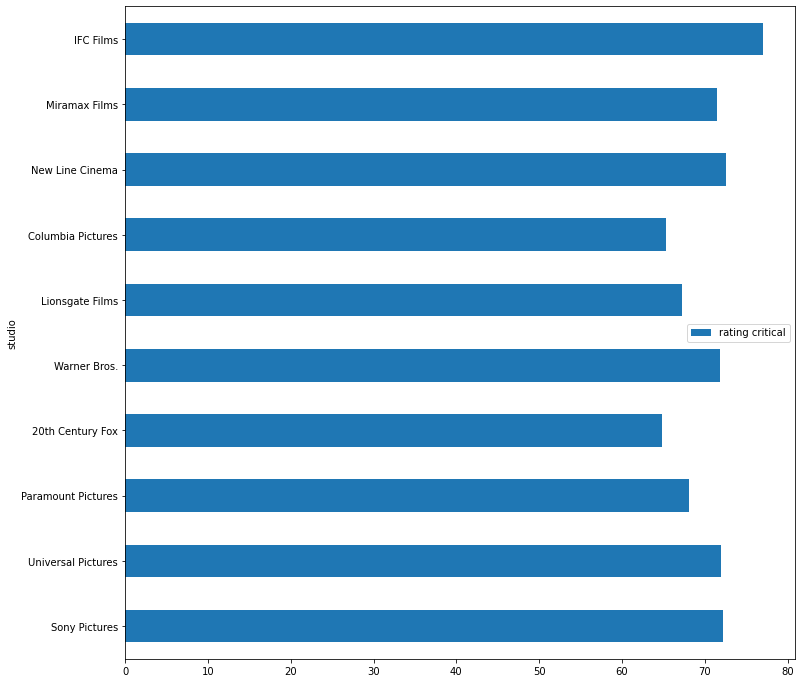

In [196]:
toptenstudios.plot('studio', 'rating critical', kind='barh', figsize = (12,12))

In [40]:
joinedrtstudio.head(50)

,synopsis,rating guidelines,genre,director,writer,theater_date,dvd_date,currency,box_office,runtime,studio,id,review,rating critical,fresh,critic,top_critic,publisher,date,freshnum
id,,,,,,,,,,,,,,,,,,,,
419,"When teens mysteriously develop powerful new abilities, they are declared a threat by the government and detained. Sixteen-year-old Ruby, one of the most powerful young people anyone has encountered, escapes her camp and joins a group of runaway teens seeking safe haven. Soon this newfound family realizes that, in a world in which the adults in power have betrayed them, running is not enough and they must wage a resistance, using their collective power to take back control of their future.",PG-13,Mystery and Suspense|Science Fiction and Fantasy,Jennifer Yuh Nelson,Chad Hodge,"Aug 3, 2018","Oct 30, 2018",NaN,NaN,105 minutes,20th Century Fox,10,"With little visible talent and no energy, Colin Hanks is in bad need of major acting lessons and maybe a little coffee.",37.5,rotten,Steve Rhodes,0,Internet Reviews,"January 9, 2002",0
1123,"The sequel to the cult classic The Rocky Horror Picture Show, this film follows the further adventures of Brad (Cliff De Young) and Janet (Jessica Harper), as the now-married couple travels to a small town to appear on a game show. However, once on-stage, they discover that they are trapped on the television show with a bunch of unusual characters.",PG,Comedy|Musical and Performing Arts|Television,Jim Sharman,NaN,"Oct 13, 1981","Sep 5, 2006",NaN,NaN,94 minutes,20th Century Fox,33,"Director Keith Gordon emphasizes the speeches more than other issues, and his otherwise thoughtful movie needlessly romanticizes hate.",63.0,rotten,Gene Siskel,1,Chicago Tribune,"August 23, 2017",0
1383,"Through a series of misunderstandings, Alvin, Simon and Theodore come to believe that Dave is going to propose to his new girlfriend in Miami...and dump them. They have three days to get to him and stop the proposal, saving themselves not only from losing Dave but possibly from gaining a terrible stepbrother. (C) Fox",PG,Animation|Comedy|Kids and Family,Walt Becker,NaN,"Dec 18, 2015","Mar 15, 2016",$,"66,580,191",86 minutes,20th Century Fox,40,"While we'd like it if the film had managed to be less schematic, had succeeded in fulfilling its sociological aims in more humanistic terms, we're willing to cut it slack because it sometimes seems no one else is even trying.",60.0,fresh,Kenneth Turan,1,Los Angeles Times,"September 18, 2003",1
153,"Meet the kid who made ""wimpy"" cool in a family comedy based on the best-selling illustrated novel Diary of a Wimpy Kid by Jeff Kinney, the first in a series that has thus far sold 24 million copies. ""Diary of a Wimpy Kid"" chronicles the adventures of wise-cracking pre-teen Greg Heffley, who must somehow survive the scariest time of anyone's life: middle school.",PG,Comedy|Kids and Family,Thor Freudenthal,Jackie Filgo|Jeff Filgo|Gabe Sachs|Jeff Judah,"Mar 19, 2010","Aug 3, 2010",$,"64,001,297",93 minutes,20th Century Fox,3,"What we can't argue is that Cosmopolis is the work of a master filmmaker, one who is determined to have us think about the ideas packed into the trunk of this limo bound for the furthest corners of the psyche.",NaN,fresh,Peter Howell,1,Toronto Star,"May 25, 2012",1
1527,"Welcome to Mooseport. The sleepy Maine community has all the accoutrements of idyllic small town life: a little park and gazebo, quaint architecture, a moose that wanders through the streets, and lots of friendly townsfolk, including the proprietor of the local hardware store, Handy Harrison and his veterinarian girlfriend Sally. Mooseport also just happens to be the vacation home for the leader of the free world: Monroe ""Eagle"" Cole, the President of the United States. Following two successful terms, the wildly popular President is ready to retire to his ""Mooseport White House,"" publish his memoirs and embark on a series of lucrative speaking engagements. But Eagle's retirement is delayed w

<AxesSubplot:xlabel='studio'>

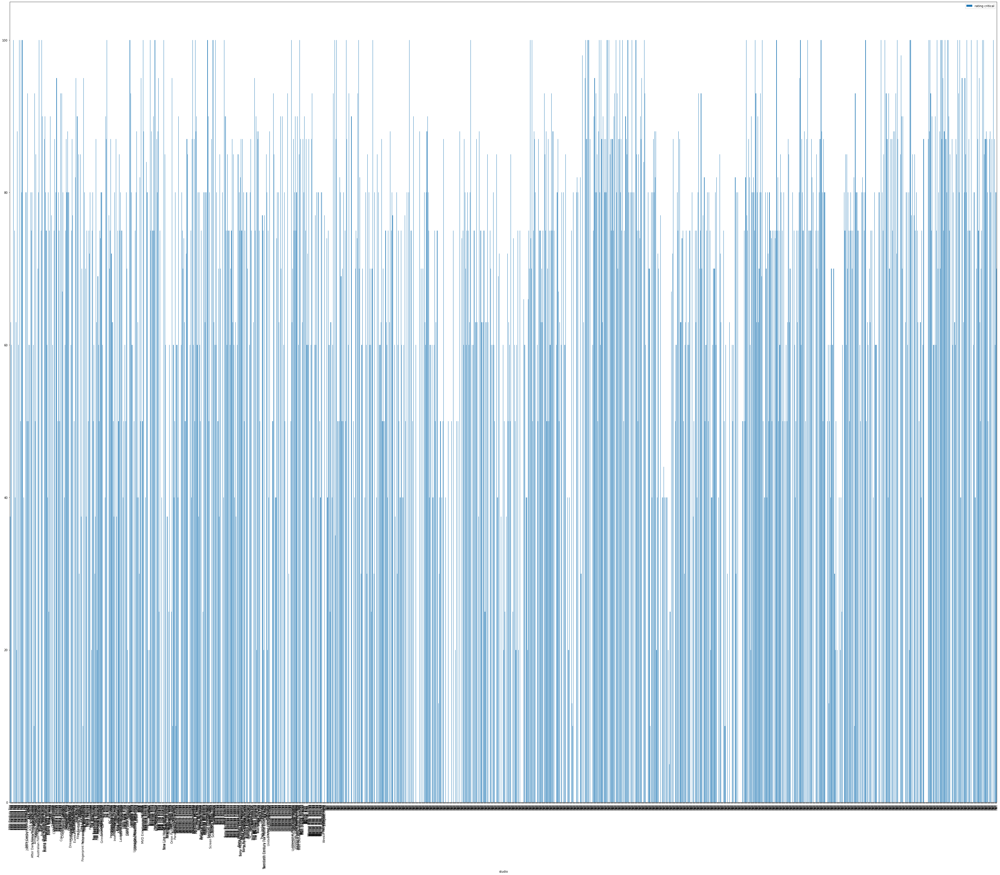

In [41]:
joinedrtstudio.plot('studio', 'rating critical', kind='bar', figsize = (60,50))

<AxesSubplot:xlabel='studio'>

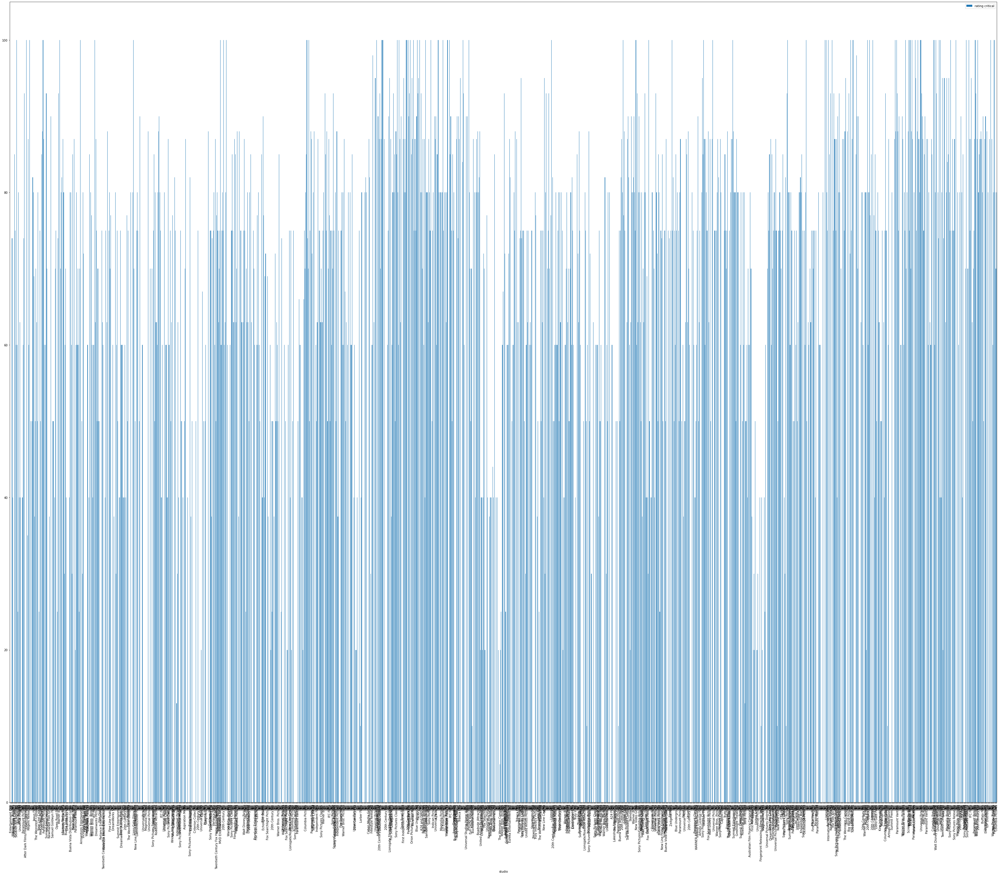

In [67]:
joinedrt.plot('studio', 'rating critical', kind='bar', figsize = (60,50))

# Visualizations!

Text(0.5, 1.0, 'Runtime vs Critical Rating')

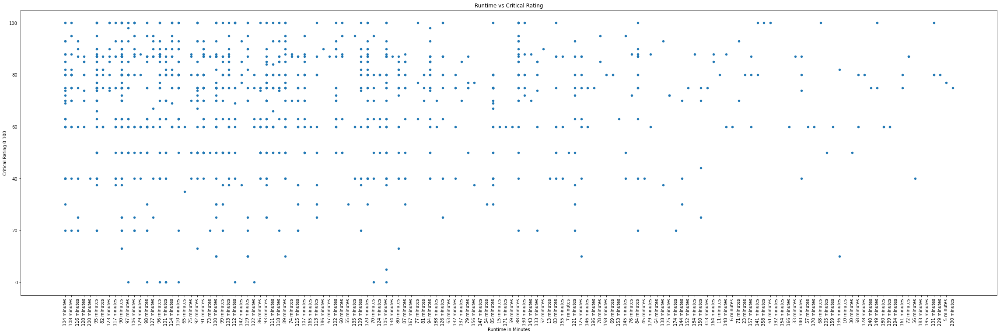

In [42]:
joinedrt.plot('runtime', 'rating critical', kind='scatter', figsize = (40,12))

plt.xticks(rotation = 90);
plt.xlabel('Runtime in Minutes')
plt.ylabel('Critical Rating 0-100')
plt.title('Runtime vs Critical Rating')



TypeError: can only concatenate str (not "float") to str

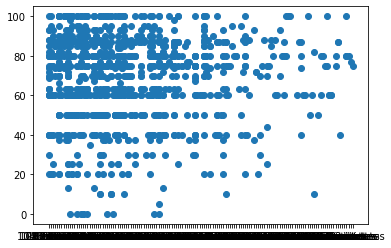

In [32]:
joinedrt.plot('publisher', 'rating critical', kind='s', figsize = (40,12))

In [ ]:
joinedrt['runtimecat'] = joinedrt['runtime']

<AxesSubplot:xlabel='freshnum', ylabel='runtime'>

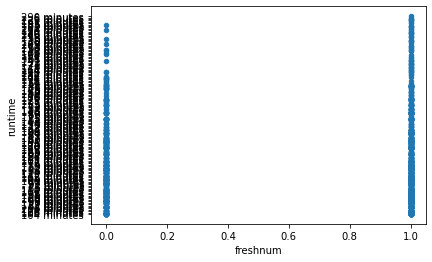

In [60]:
joinedrt.plot('freshnum', 'runtime', kind='scatter')

In [ ]:
runtimevsfreshhist, ax = plt.subplots(figsize=(15, 8))


ax.hist(df['Age'], bins = 80, color = 'blue');

ax.set_xlabel('Age')
ax.set_ylabel('Frquency')
ax.set_title('Histogram of Ages on the Titanic')